In [5]:
# import necessary modules
import numpy as np
import os
import matplotlib.pyplot as plt
import netCDF4 as nc
import matplotlib.colors as mcolors
import random
from mpl_toolkits.basemap import Basemap
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from matplotlib import gridspec
from sklearn.neighbors import NearestNeighbors

In [6]:
#get the file path for loading, data file is under the same dir with the notebook
filename="20121015_00_ecmwf_ensemble_forecast.PRESSURE_LEVELS.EUR_LL10.120.pl.nc"
filepath=os.path.join(os.getcwd(),filename)

# read the raw data and extract the needed data
# exrtact the value of Geopotential under the pressure of 500 hPA in the certain
Pressure_Levels_data = nc.Dataset(filepath,"r")

In [7]:
# get all the dimension value
nd_1,nd_2,nd_3,nd_4,nd_5 = Pressure_Levels_data.variables['Geopotential_isobaric'][:].shape
# get the necessary raw data
Geopotential_Isobaric_500 = Pressure_Levels_data.variables['Geopotential_isobaric'][0,:,7,:,:] / 9.80655
# reshape the dataset into form of (51,41*101)
Geopotential_Isobaric_500_reshaped = np.reshape(Pressure_Levels_data.variables['Geopotential_isobaric'][0,:,7,:,:],(nd_2, nd_4 * nd_5))
# prepare the longitude and latitude value for contour
longitude = Pressure_Levels_data['lon'][:]
latitude = Pressure_Levels_data['lat'][:]
(lon, lat) = np.meshgrid(longitude, latitude)

In [8]:
# use PCA to reduce dimensions under the condition of reaching 80% of all the member infomation
exp_var = 0
n_pc = 0
while exp_var < 0.8:
    n_pc = n_pc + 1
    pca = PCA(n_components = n_pc)
    pca.fit(Geopotential_Isobaric_500_reshaped)
    exp_var = sum(pca.explained_variance_ratio_)

# get the transformed raw data in the dimension-reduced space    
pca_transformed_data = pca.transform(Geopotential_Isobaric_500_reshaped)

In [9]:
pca_components = np.reshape(pca.components_, (9,nd_4,nd_5)) 
pca_components_hist = np.reshape(pca.components_,(1,nd_4*nd_5*9))

In [10]:
# recreate the raw data using the eigenvector and transformed data
recreated_raw_data = np.reshape((np.dot(pca_transformed_data, pca.components_) + pca.mean_), (51, 41, 101))/9.80655

In [11]:
# use kmeans to cluster the transformed data
kmeans = KMeans(init = "k-means++", n_clusters = 3, n_init = 10).fit(pca_transformed_data)

We choose the first two components to draw scatter plot since they can represent the most of the information and be plotted in 2D dimensions at the same time. The spaghetti plot shows all the 51 ensemble members at the height of 5600m, sorted and colored by the cluster. The scatter plot on the right shows the distribution of each member, representing by the first two components and colored by cluster. The next three section show each cluster and spaghetti plot respectively, from which we can figure out how these 51 emsemble members are clustered.

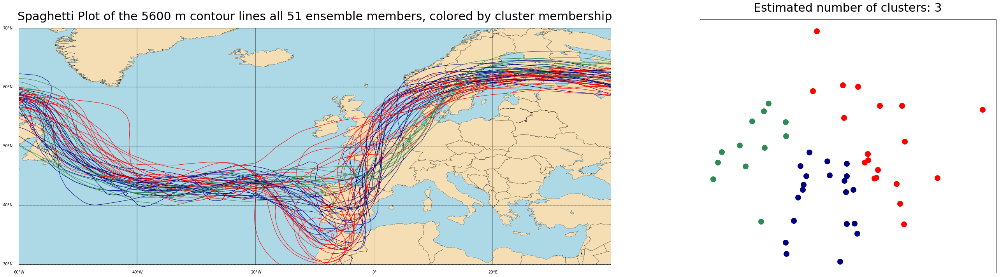

In [7]:
# get the cluster result in forms of labels
labels = kmeans.labels_
# Number of clusters in labels, ignoring noise if exist.
n_clusters_ = len(set(labels))
# set color scope
arr_colors = ["red","seagreen","navy","orangered","cyan"]
colors=arr_colors[0:len(set(labels))]
# extract unique label
unique_labels = set(labels)

fig = plt.subplots(figsize = (45, 12))
gs = gridspec.GridSpec(1, 2, width_ratios=[2, 1])
ax0 = plt.subplot(gs[0])
ax0.set_title("Spaghetti Plot of the 5600 m contour lines all 51 ensemble members, colored by cluster membership", fontsize = 30, pad = 20)
map1 = Basemap(projection ='cyl',llcrnrlat = latitude[-1], urcrnrlat = latitude[0], resolution ='l',  llcrnrlon = longitude[0], urcrnrlon = longitude[-1])
map1.drawcoastlines(linewidth = 0.3)
map1.drawmapboundary(fill_color ="lightblue")
map1.fillcontinents(color = "wheat")
map1.drawcountries()
map1.drawparallels(np.arange(30, 75, 10), labels = [True,False,False,False])
map1.drawmeridians(np.arange(-60, 40, 20), labels = [False,False,False,True])

for index, value in enumerate(labels):
        map1.contour(lon, lat, Geopotential_Isobaric_500[index, :, :], levels = [5600], colors = colors[value], linewidths = 1)

ax1 = plt.subplot(gs[1])
ax1.set_title('Estimated number of clusters: %d' % n_clusters_, fontsize = 30, pad = 20)
for l, c in zip(unique_labels, colors):   
    selected_data = pca_transformed_data[labels == l]
    ax1.plot(selected_data[:, 0], selected_data[:, 1], 'o', markerfacecolor = c, markeredgecolor = c, markersize = 14)

ax1.set_xticks(())
ax1.set_yticks(())

plt.show()

In [25]:
def clusterAndSpaghetti(constant):
    sumNum = len(labels[labels == constant])
    # plot seperatly clustered scatter and spaghetti plot
    fig = plt.figure(1, figsize = (36, 9 * (sumNum + 1)))
    gridspec.GridSpec(sumNum + 1, 4)
    plt.subplot2grid((sumNum + 1, 4), (0,0), colspan = 3)
    map1 = Basemap(projection = 'cyl',llcrnrlat = latitude[-1], urcrnrlat = latitude[0], resolution ='l',  llcrnrlon = longitude[0], urcrnrlon = longitude[-1])
    map1.drawcoastlines(linewidth = 0.3)
    map1.drawmapboundary(fill_color = "lightblue")
    map1.fillcontinents(color = "wheat")
    map1.drawcountries()
    map1.drawparallels(np.arange(30, 75, 10), labels = [True,False,False,False])
    map1.drawmeridians(np.arange(-60, 40, 20), labels = [False,False,False,True])

    for index, value in enumerate(labels):
        if value == constant:
            map1.contour(lon, lat, Geopotential_Isobaric_500[index, :, :], levels = [5600], colors = colors[value], linewidths = 1)
    plt.title("Spaghetti Plot of the 5600 m contour lines all %d ensemble members, colored by cluster membership" % sumNum, fontsize = 20, pad = 20)


    plt.subplot2grid((sumNum + 1, 4), (0,3))
    plt.title('Estimated number of clusters: %d' % n_clusters_, fontsize = 20, pad = 20)
    for l, c in zip(unique_labels, colors): 
        selected_data = pca_transformed_data[labels == l]
        if l == constant:
            plt.plot(selected_data[:, 0], selected_data[:, 1], 'o', markerfacecolor = c, markeredgecolor = c, markersize = 14)
        else:
            plt.plot(selected_data[:, 0], selected_data[:, 1], 'o', markerfacecolor = 'w', markeredgecolor = 'w', markersize = 14)


    plt.xticks(())
    plt.yticks(())

    constIndex = [i for i, x in enumerate(labels) if x == constant]
    for i in range(sumNum):
        plt.subplot2grid((sumNum + 1, 4), (i + 1, 0), colspan = 2)
        map1 = Basemap(projection ='cyl',llcrnrlat = latitude[-1],urcrnrlat = latitude[0],resolution ='l', llcrnrlon = longitude[0], urcrnrlon = longitude[-1])
        map1.drawcoastlines(linewidth = 0.3)
        map1.contourf(lon, lat, Geopotential_Isobaric_500[constIndex[i]],cmap = 'afmhot_r')

        plt.subplot2grid((sumNum + 1, 4), (i + 1, 2), colspan = 2)
        map1 = Basemap(projection ='cyl',llcrnrlat = latitude[-1],urcrnrlat = latitude[0],resolution ='l', llcrnrlon = longitude[0], urcrnrlon = longitude[-1])
        map1.drawcoastlines(linewidth = 0.3)
        map1.contourf(lon, lat, recreated_raw_data[constIndex[i]],cmap = 'afmhot_r')


    plt.show()

The following three parts show each cluster with scatter plot and corresponding spathetti plot, below which are the contour filled plot of from the original data and recreated data.

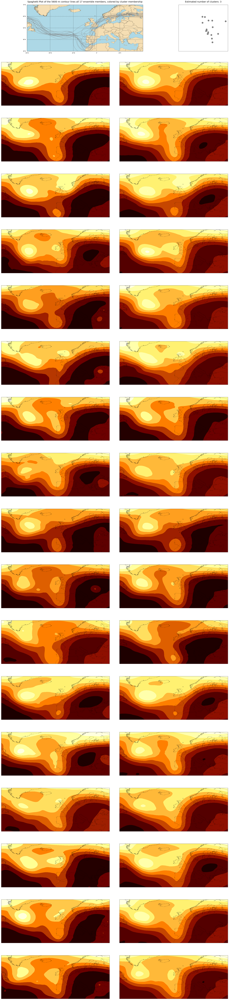

In [26]:
clusterAndSpaghetti(0)

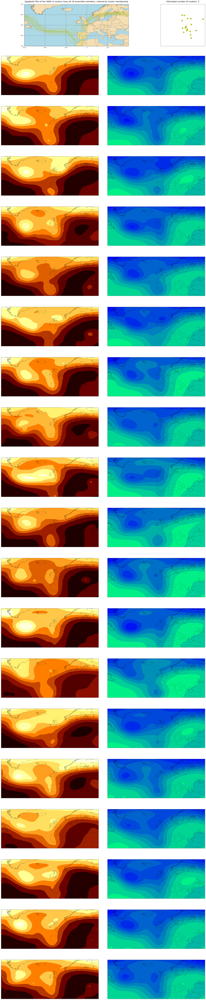

In [38]:
clusterAndSpaghetti(1)

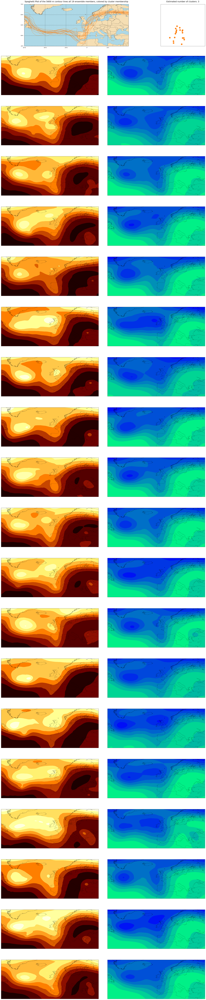

In [39]:
clusterAndSpaghetti(2)

We then ust DBSCAN to cluster again, using the same combination of plots to compare. The result shows less then 51 members because the original DBSCAN algorithm chooses some points as noise and normally we ignore these points. In our case, only 35 members are meaningfully clustered. But we can see that some outlier are ignored in DBSCAN but not in KMeans.

In [161]:

db = DBSCAN(eps = 19500, min_samples = 5).fit(pca_transformed_data)
index = np.array(np.where(db.labels_==0)) 
print(index+1)
index = np.array(np.where(db.labels_==1)) 
print(index+1)
index = np.array(np.where(db.labels_==2)) 
print(index+1)
index = np.array(np.where(db.labels_==-1)) 
print(index+1)

[[ 1  3  4  5  6  8  9 13 16 21 22 23 25 26 32 33 35 36 37 40 41 43 45 50
  51]]
[[ 2 10 18 30 47]]
[[27 31 44 46 48]]
[[ 7 11 12 14 15 17 19 20 24 28 29 34 38 39 42 49]]


(array([2., 2., 0., 8., 4., 1., 0., 2., 2., 2., 7., 5., 5., 0., 2., 1., 7.,
        2., 2., 3., 1., 6., 5., 7., 9., 0., 5., 4., 7., 4., 3., 2., 4., 5.,
        1., 2., 1., 0., 1., 2., 1., 0., 1., 1., 1., 1., 0., 1., 1., 0., 2.,
        3., 0., 0., 0., 2., 0., 3., 0., 1., 3., 0., 0., 0., 2., 0., 0., 1.,
        1., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.]),
 array([13285.28781121, 13533.00826535, 13780.72871949, 14028.44917363,
        14276.16962777, 14523.8900819 , 14771.61053604, 15019.33099018,
        15267.05144432, 15514.77189846, 15762.4923526 , 16010.21280674,
        16257.93326088, 16505.65371501, 16753.37416915, 17001.09462329,
        17248.81507743, 17496.53553157, 17744.25598571, 17991.97643985,
        18239.69689399, 18487.41734813, 18735.13780226, 18982.8582564 ,
        19230.57871054, 19478.29916468, 19726.01961882, 19973.74007296,
        20221.4605271 , 20469.18098124, 20716.

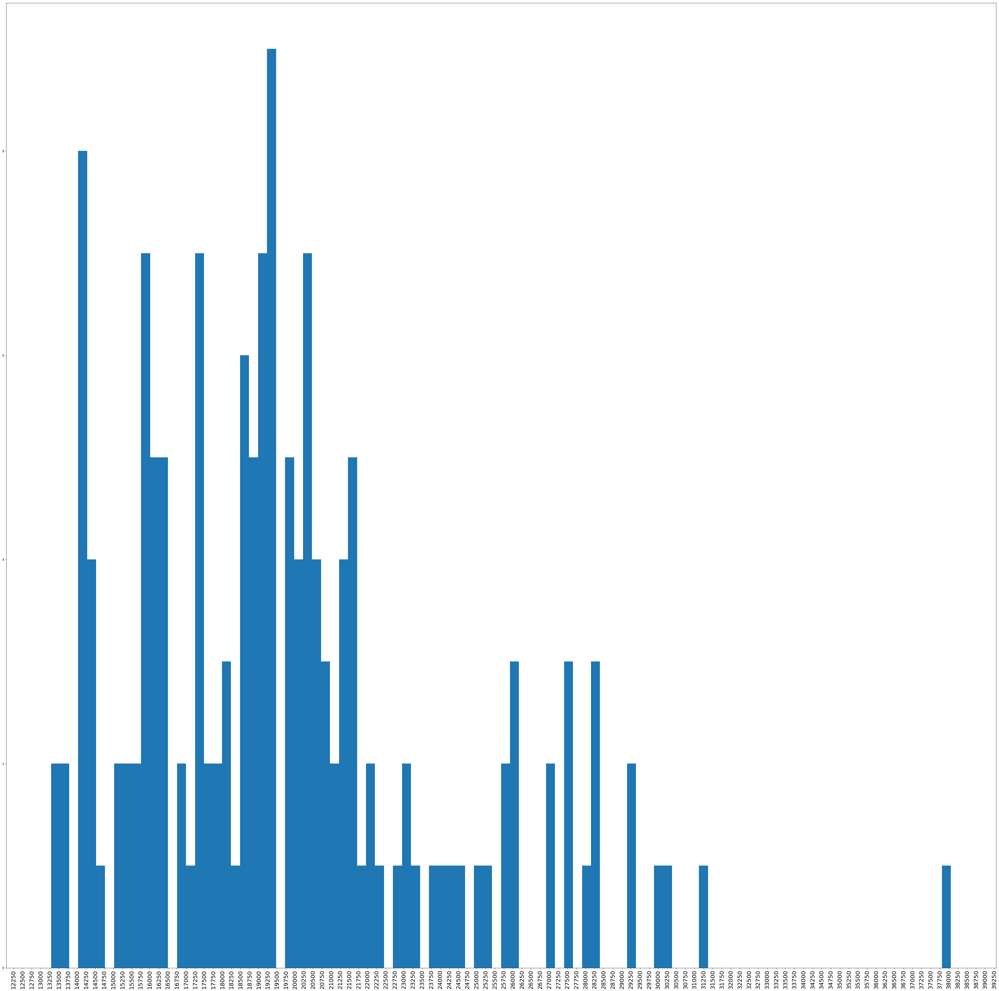

In [180]:
ns = 5
nbrs = NearestNeighbors(n_neighbors=ns).fit(pca_transformed_data)
distances, indices = nbrs.kneighbors(pca_transformed_data)
fig, ax= plt.subplots(figsize=(60,60))
plt.xticks(np.arange(0, 40000, step=250), rotation=90, fontsize=20)

plt.hist((np.reshape(distances[:,1:4], (1,51*3))).T,100)

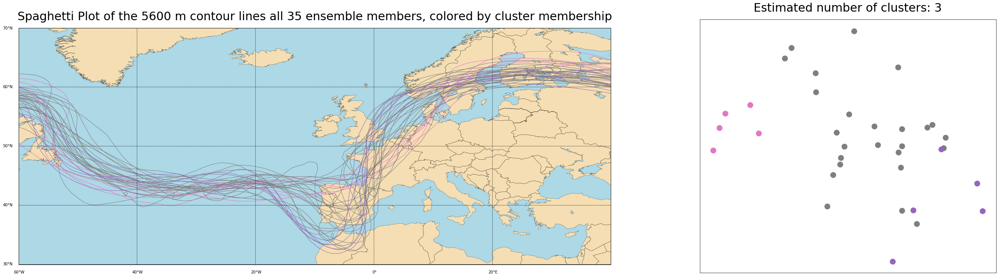

In [182]:
# get the cluster result in forms of labels
labels = db.labels_
# Number of clusters in labels, ignoring noise if exist.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
# set color scope
colors = [list(mcolors.TABLEAU_COLORS.keys())[x] for x in random.sample(range(0,len(mcolors.TABLEAU_COLORS)),n_clusters_)]
# extract unique label
unique_labels = set(labels)

fig = plt.subplots(figsize = (45, 12))
gs = gridspec.GridSpec(1, 2, width_ratios=[2, 1])
ax0 = plt.subplot(gs[0])
ignore, minusNumber =np.array(np.where(db.labels_== -1)).shape
restNumber = 51- minusNumber
ax0.set_title("Spaghetti Plot of the 5600 m contour lines all %d ensemble members, colored by cluster membership" %restNumber, fontsize = 30, pad = 20)
map1 = Basemap(projection ='cyl',llcrnrlat = latitude[-1], urcrnrlat = latitude[0], resolution ='l',  llcrnrlon = longitude[0], urcrnrlon = longitude[-1])
map1.drawcoastlines(linewidth = 0.3)
map1.drawmapboundary(fill_color ="lightblue")
map1.fillcontinents(color = "wheat")
map1.drawcountries()
map1.drawparallels(np.arange(30, 75, 10), labels = [True,False,False,False])
map1.drawmeridians(np.arange(-60, 40, 20), labels = [False,False,False,True])

for index, value in enumerate(labels):
    if np.isin(index, np.where(db.labels_== -1)) == False:
        map1.contour(lon, lat, Geopotential_Isobaric_500[index, :, :], levels = [5600], colors = colors[value], linewidths = 1)

ax1 = plt.subplot(gs[1])
ax1.set_title('Estimated number of clusters: %d' % n_clusters_, fontsize = 30, pad = 20)
for l, c in zip(unique_labels, colors):  
    if l != -1:

        selected_data = pca_transformed_data[labels == l]
        ax1.plot(selected_data[:, 0], selected_data[:, 1], 'o', markerfacecolor = c, markeredgecolor = c, markersize = 14)
    

ax1.set_xticks(())
ax1.set_yticks(())

plt.show()

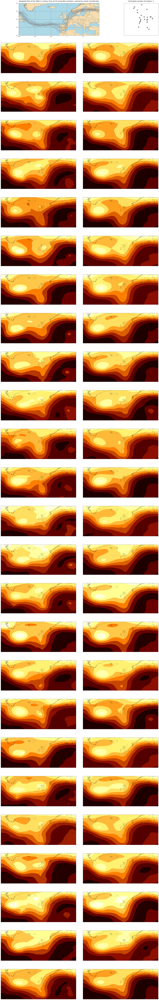

In [183]:
clusterAndSpaghetti(0)

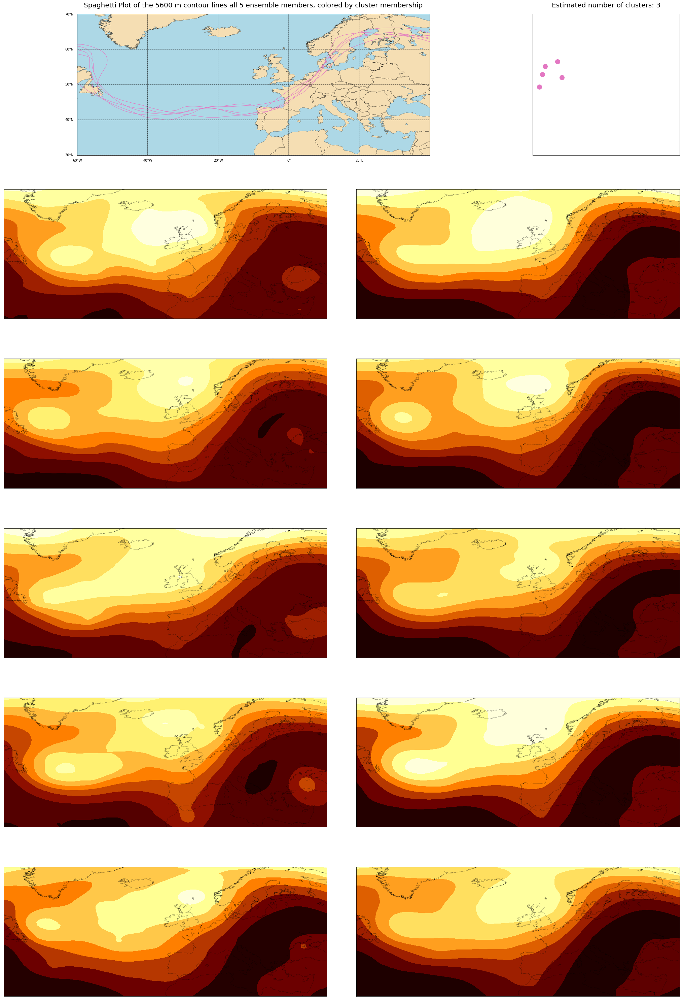

In [184]:
clusterAndSpaghetti(1)

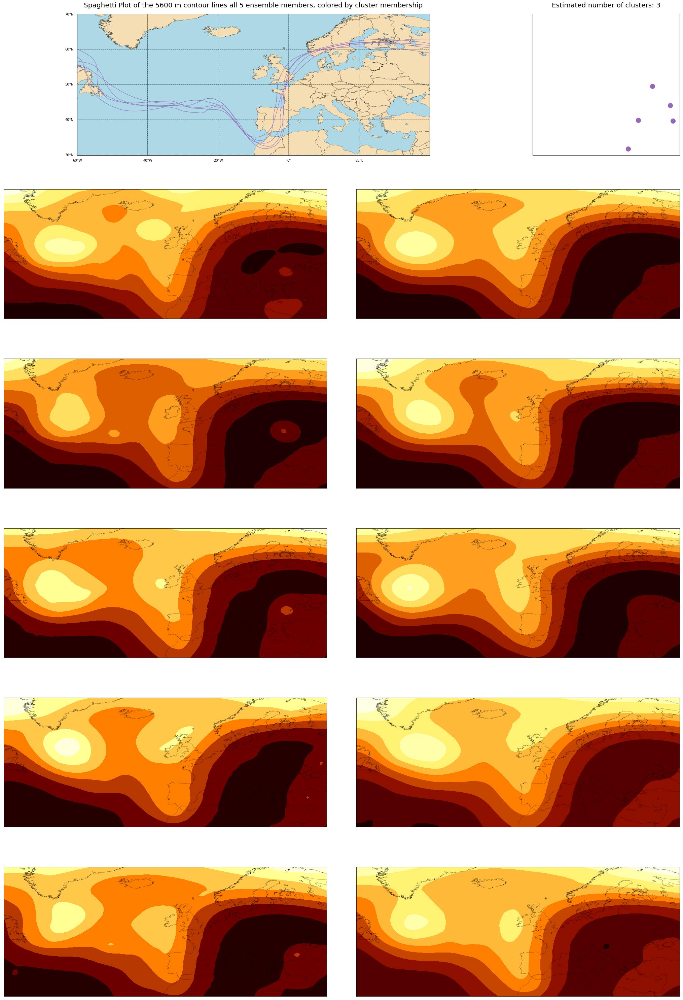

In [185]:
clusterAndSpaghetti(2)